<a href="https://colab.research.google.com/github/ML-ctrl/Thesis-ML_2022/blob/main/CV_Salvini.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

IMPORT AND DISPLAY DATASET

In [ ]:
import pandas as pd
import gdown

# Download the file using gdown
url = 'https://drive.google.com/uc?id=1A8oJ5RcZMVEfbh7vCyrVRDWubkdGj_To'
output = 'Salvini_posts.xlsx'
gdown.download(url, output, quiet=False)

# Read the downloaded Excel file into a Pandas DataFrame
df = pd.read_excel(output, header=None, names=['id', 'caption', 'url'])

# Display the first few rows of the DataFrame to understand what it looks like
print(df.head())

Downloading...
From: https://drive.google.com/uc?id=1A8oJ5RcZMVEfbh7vCyrVRDWubkdGj_To
To: /content/Salvini_posts.xlsx
100%|██████████| 35.9k/35.9k [00:00<00:00, 58.4MB/s]


                    id                                            caption  \
0                   id                                            caption   
1  3321651402860210567  Avete seguito su Rete4 con Nicola Porro?\nSull...   
2  3316541148883335922  ✅ Giornata storica oggi a Genova, dove sono pa...   
3  3315726828536783686  ♻️ Da guardare fino alla fine!\n\nOggi a Monto...   
4  3322177843209290932  Ennesima FOLLIA europea.\n\nGrazie all’impegno...   

                                        url  
0                                       url  
1  https://www.instagram.com/p/C4Y4FofKSmH/  
2  https://www.instagram.com/p/C4GuJpmKDry/  
3  https://www.instagram.com/p/C4D0_urKuNG/  
4  https://www.instagram.com/p/C4avyWRKcS0/  


In [ ]:
!pip install requests pillow


EXAMPLE OF IMAGE CONTAINED IN THE DF

In [ ]:
from bs4 import BeautifulSoup
import matplotlib.pyplot as plt
from PIL import Image
import requests

def display_instagram_image(instagram_url):
    try:
        # Send a GET request to the URL
        response = requests.get(instagram_url)

        # Check if the request was successful (status code 200)
        if response.status_code == 200:
            # Parse the HTML content of the page
            soup = BeautifulSoup(response.text, 'html.parser')
            # Find the meta tag containing the image URL
            meta_tag = soup.find('meta', property='og:image')
            if meta_tag:
                # Extract the content attribute (image URL) from the meta tag
                image_url = meta_tag['content']
                # Send a GET request to download the image
                image_response = requests.get(image_url)
                # Check if the image request was successful (status code 200)
                if image_response.status_code == 200:
                    # Open the image using PIL (Python Imaging Library)
                    img = Image.open(BytesIO(image_response.content))
                    # Display the image
                    plt.imshow(img)
                    plt.axis('off')
                    plt.show()
                else:
                    print("Failed to download image:", image_response.status_code)
            else:
                print("No meta tag found for image URL")
        else:
            print("Failed to fetch Instagram page:", response.status_code)
    except Exception as e:
        print("An error occurred:", str(e))

# Example usage
instagram_url = "https://www.instagram.com/p/C4GuJpmKDry/"
display_instagram_image(instagram_url)


An error occurred: name 'BytesIO' is not defined


DISPLAY ALL IMAGES

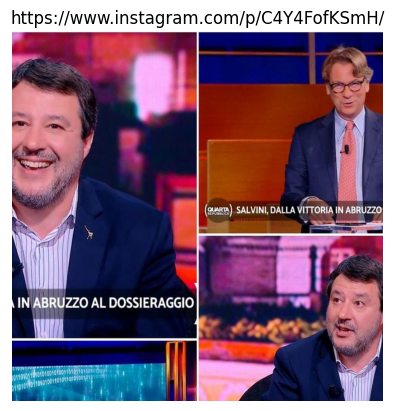

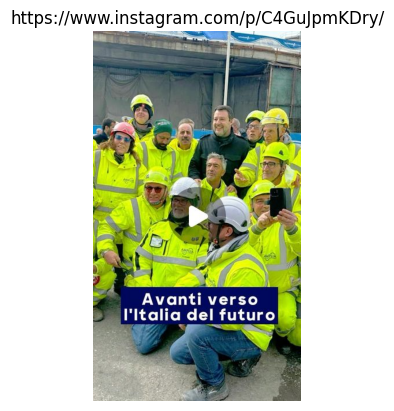

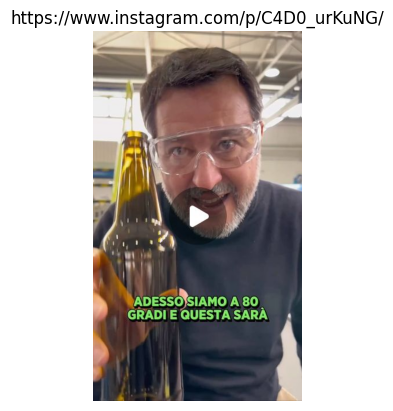

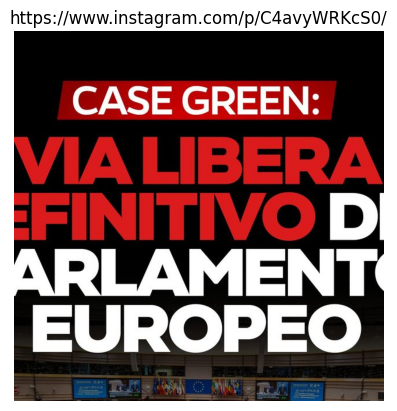

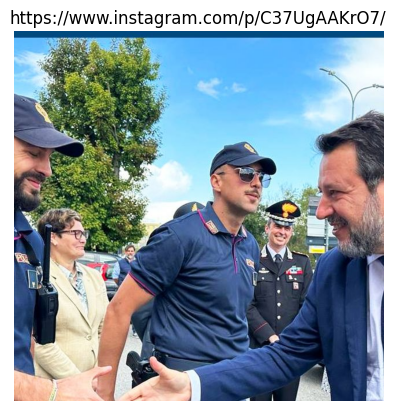

...

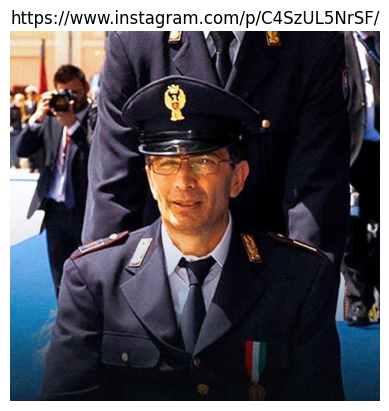

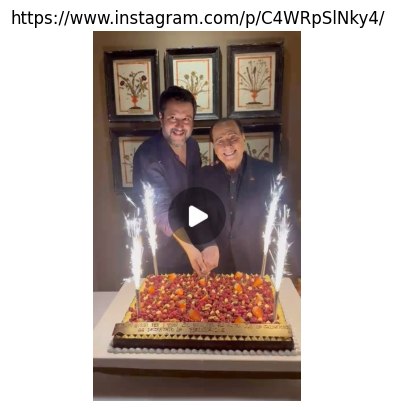

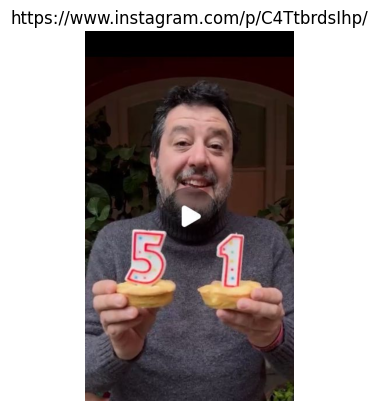

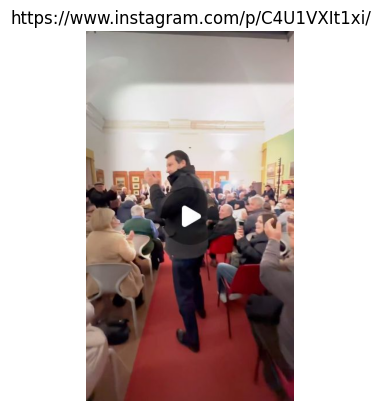

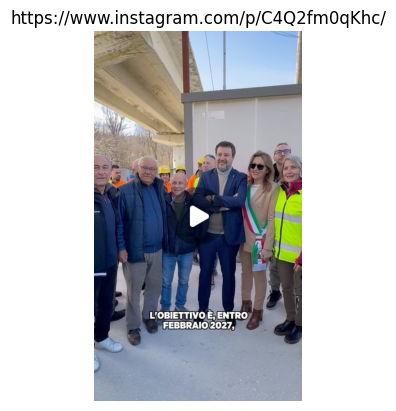

Image URL not found in https://www.instagram.com/p/C4SieRMNJIS/


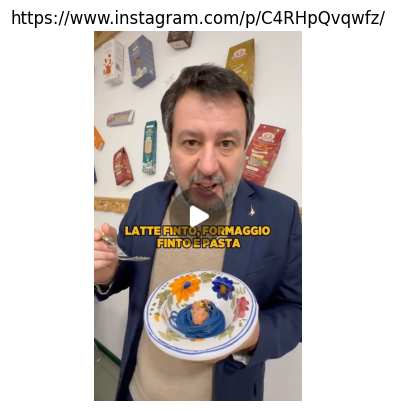

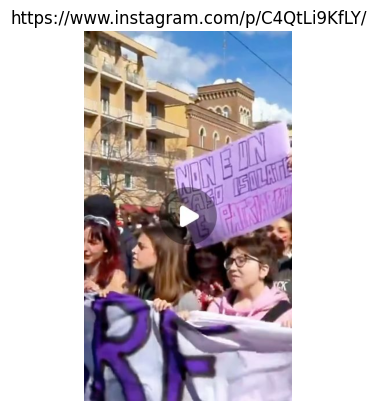

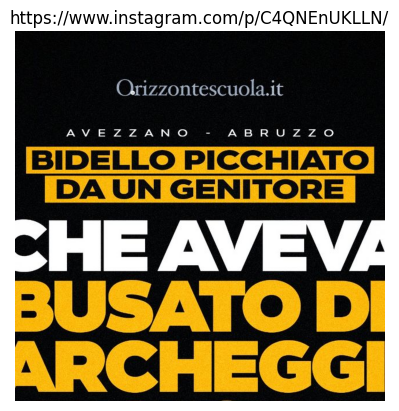

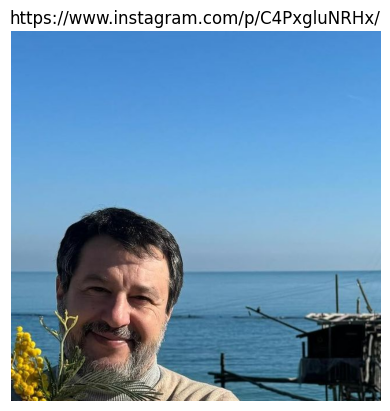

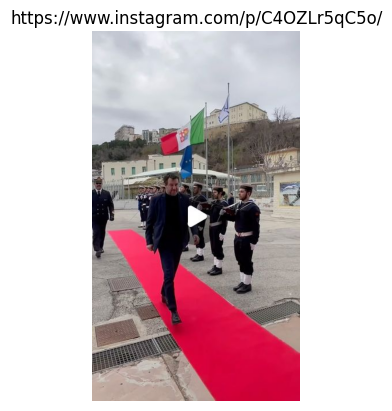

...

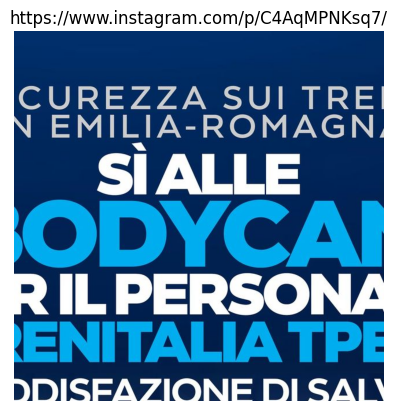

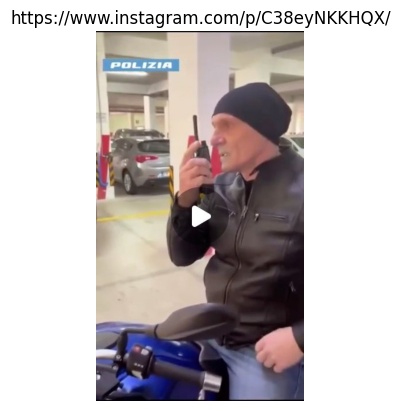

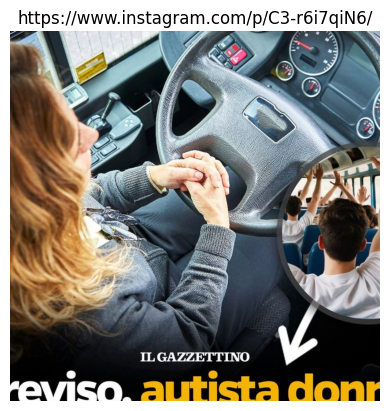

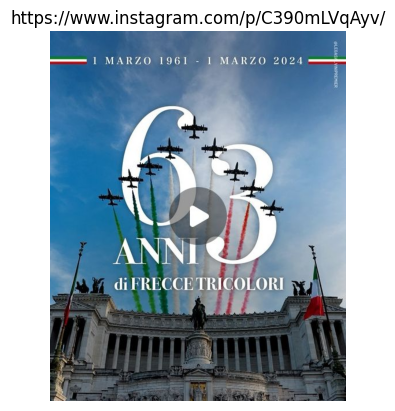

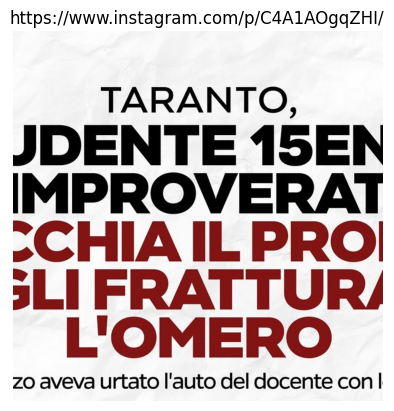

Image URL not found in https://www.instagram.com/p/C3-6LTcN3Lu/


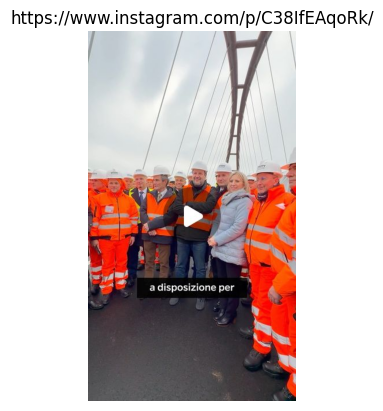

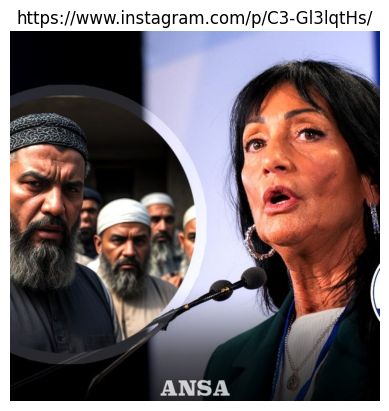

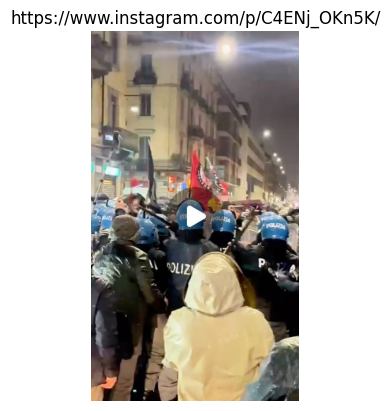

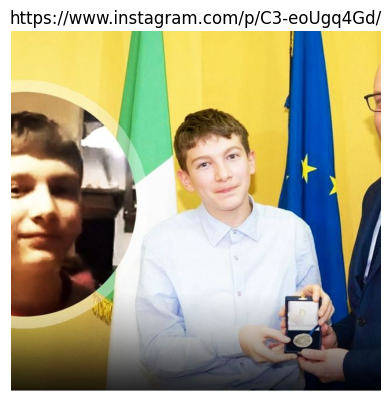

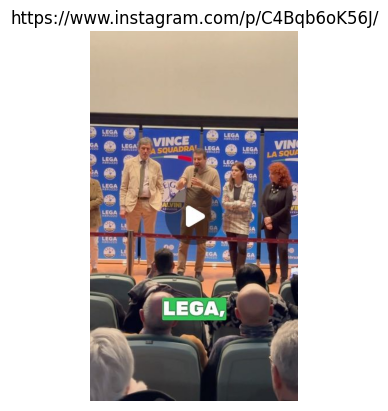

...

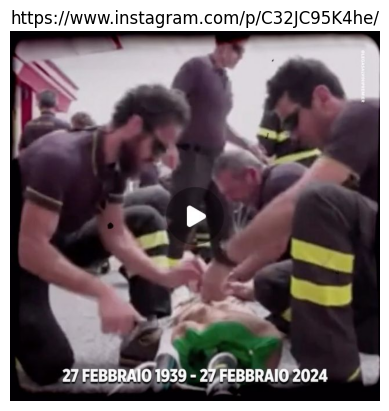

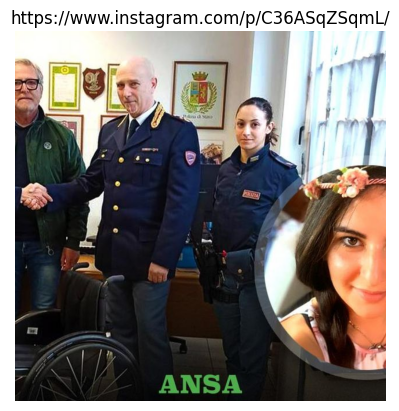

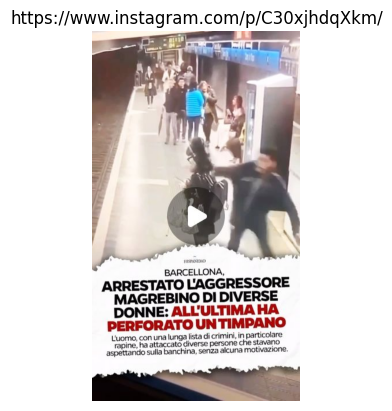

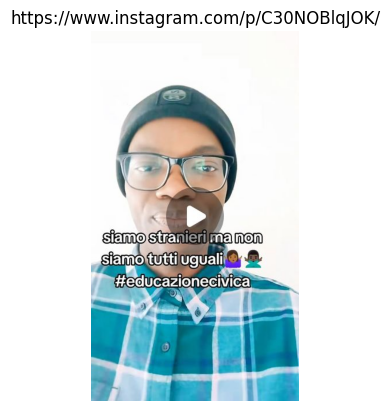

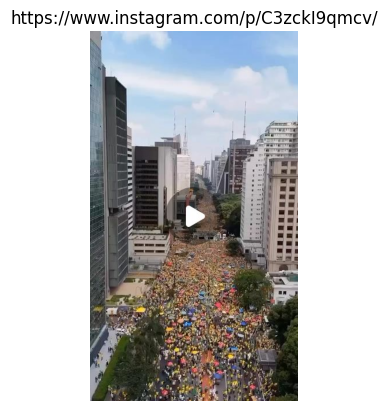

Image URL not found in https://www.instagram.com/p/C3x6CC2tsFJ/


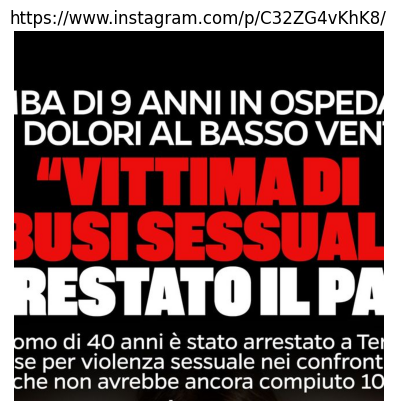

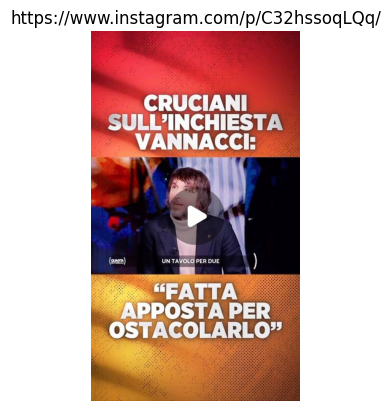

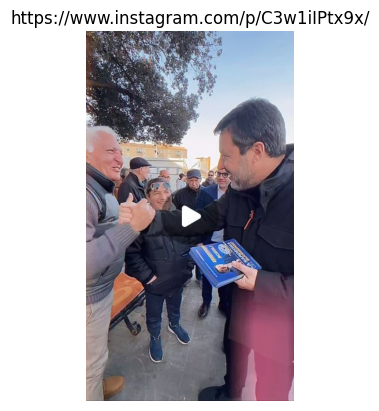

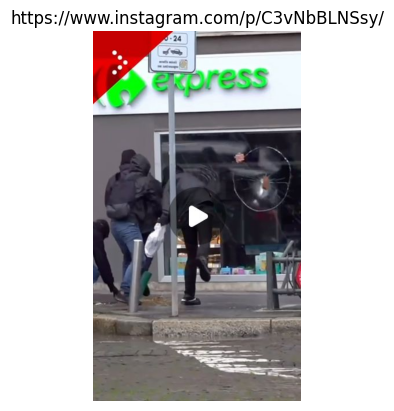

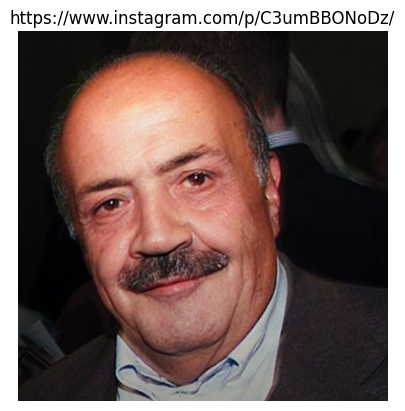

...

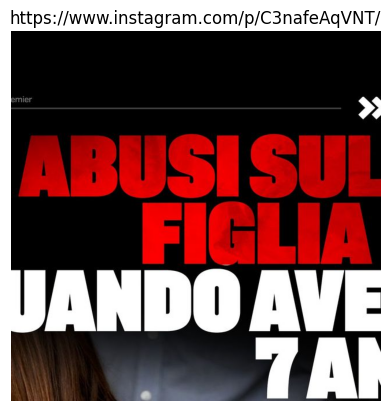

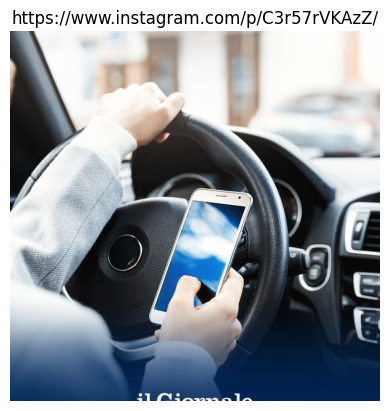

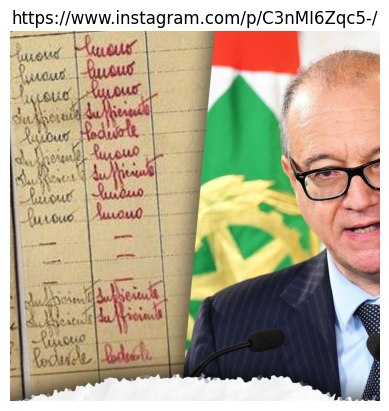

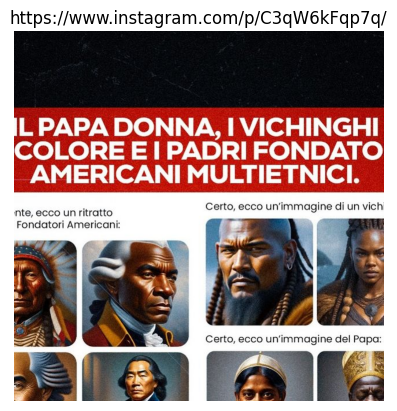

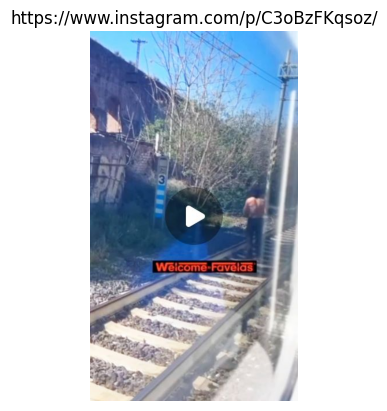

Image URL not found in https://www.instagram.com/p/C3p_SLZqT6P/


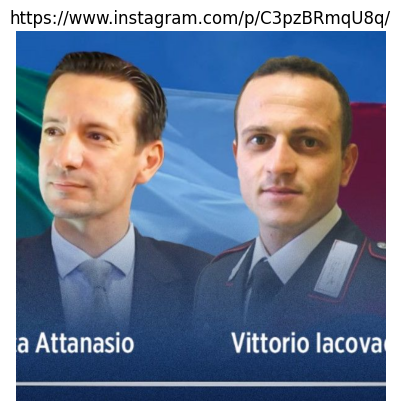

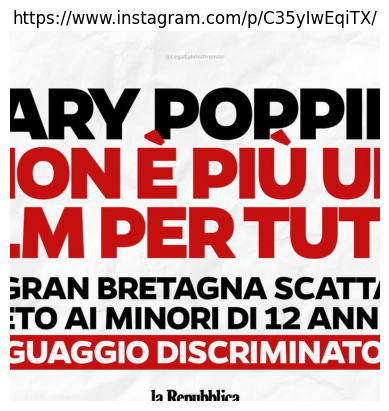

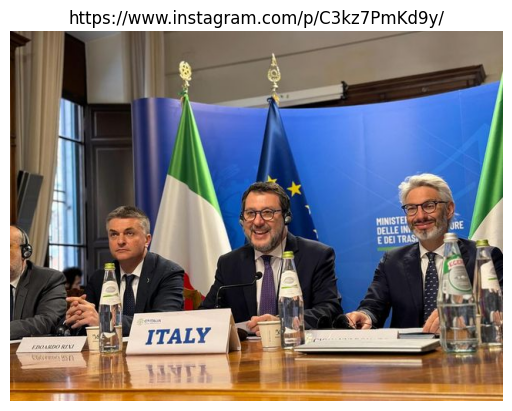

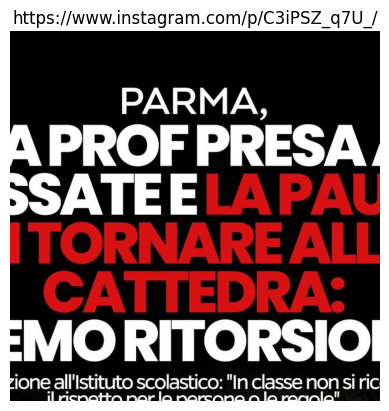

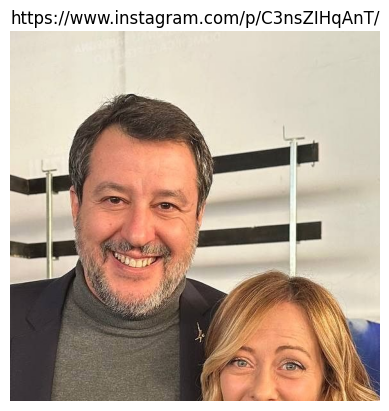

...

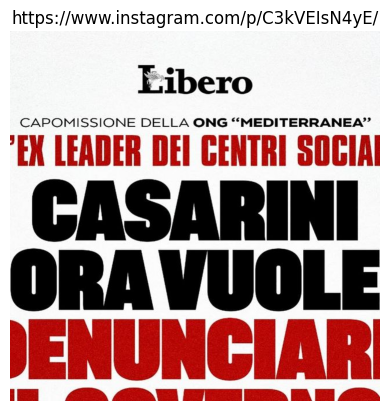

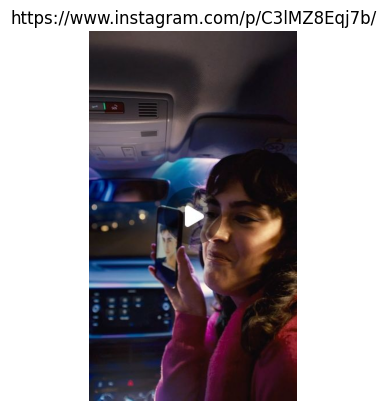

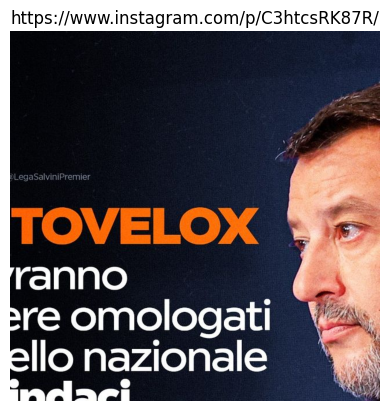

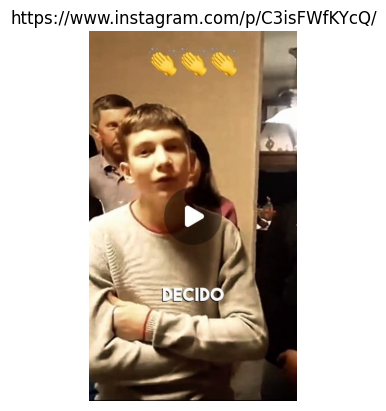

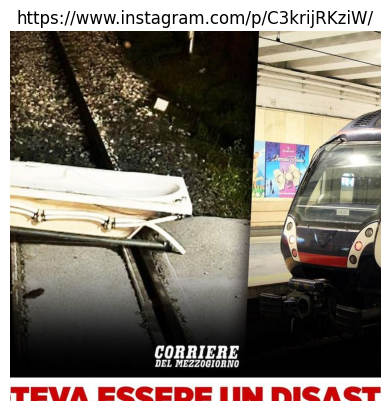

Image URL not found in https://www.instagram.com/p/C3lk4WatFhj/


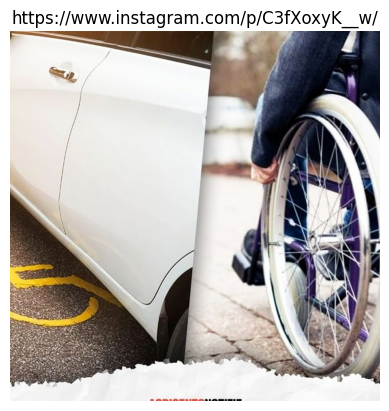

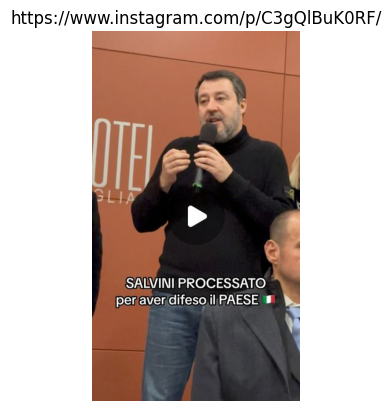

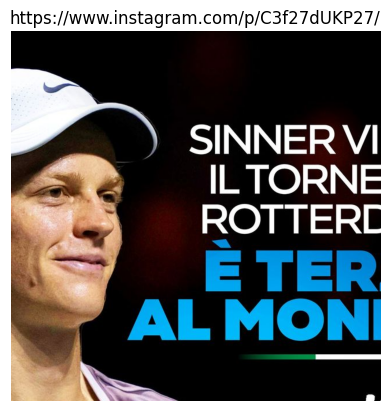

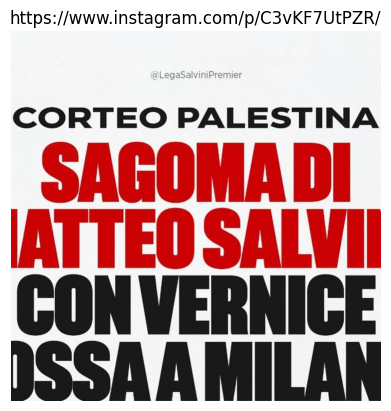

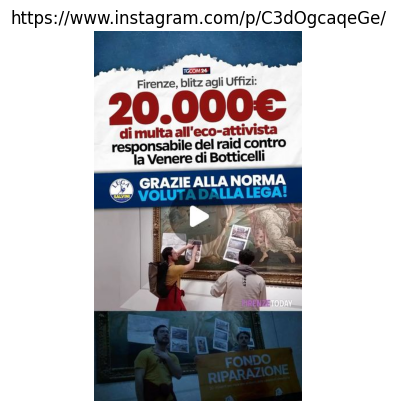

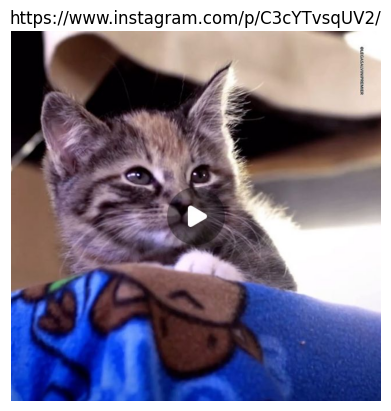

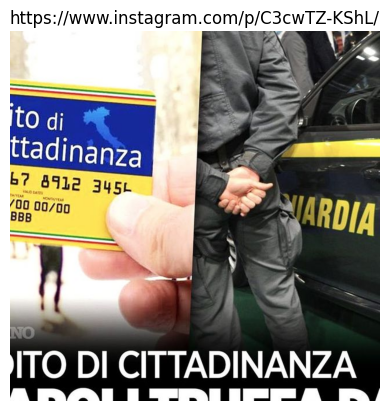

Image URL not found in https://www.instagram.com/p/C3dDHKiqa2k/


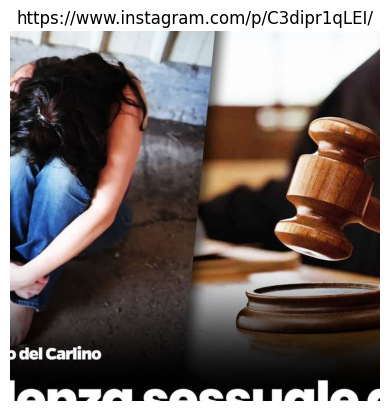

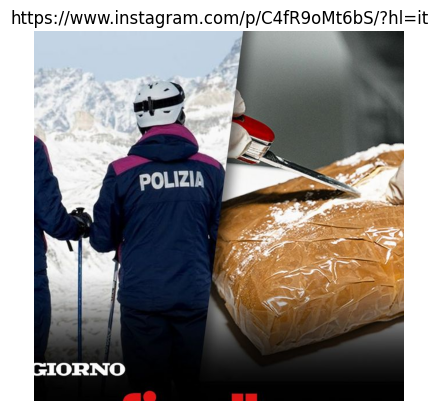

In [ ]:
import pandas as pd
import requests
from bs4 import BeautifulSoup
import matplotlib.pyplot as plt
from PIL import Image
from io import BytesIO

# Load the Excel file
excel_file = "Salvini_posts.xlsx"
df = pd.read_excel(excel_file)

# Iterate through the URLs in the 'url' column
for index, row in df.iterrows():
    # Extract the Instagram post URL from the current row
    instagram_url = row['url']

    # Send a GET request to the Instagram post URL
    response = requests.get(instagram_url)

    # Check if the request was successful (status code 200)
    if response.status_code == 200:
        # Parse the HTML content of the page
        soup = BeautifulSoup(response.text, 'html.parser')

        # Find the meta tag containing the image URL
        meta_tag = soup.find('meta', property='og:image')
        if meta_tag:
            # Extract the content attribute (image URL) from the meta tag
            image_url = meta_tag['content']

            # Send a GET request to download the image
            image_response = requests.get(image_url)

            # Check if the image request was successful (status code 200)
            if image_response.status_code == 200:
                # Open the image using PIL (Python Imaging Library)
                img = Image.open(BytesIO(image_response.content))

                # Display the image
                plt.imshow(img)
                plt.axis('off')
                plt.title(instagram_url)
                plt.show()
            else:
                print(f"Failed to download image from {instagram_url}")
        else:
            print(f"Image URL not found in {instagram_url}")
    else:
        print(f"Failed to fetch Instagram post from {instagram_url}")


DOWNLOAD ALL IMAGES AND SAVE THEM IN NEW DIRECTORY

In [ ]:
import os
import pandas as pd
import requests
from bs4 import BeautifulSoup
from PIL import Image
from io import BytesIO

# Create a directory for saving downloaded images
download_dir = "url_downloaded"
if not os.path.exists(download_dir):
    os.makedirs(download_dir)

# Load the Excel file
excel_file = "Salvini_posts.xlsx"
df = pd.read_excel(excel_file)

# Iterate through the URLs in the 'url' column
for index, row in df.iterrows():
    # Extract the Instagram post URL from the current row
    instagram_url = row['url']

    # Send a GET request to the Instagram post URL
    response = requests.get(instagram_url)

    # Check if the request was successful (status code 200)
    if response.status_code == 200:
        # Parse the HTML content of the page
        soup = BeautifulSoup(response.text, 'html.parser')

        # Find the meta tag containing the image URL
        meta_tag = soup.find('meta', property='og:image')
        if meta_tag:
            # Extract the content attribute (image URL) from the meta tag
            image_url = meta_tag['content']

            # Send a GET request to download the image
            image_response = requests.get(image_url)

            # Check if the image request was successful (status code 200)
            if image_response.status_code == 200:
                # Open the image using Python Imaging Library
                img = Image.open(BytesIO(image_response.content))

                # Save the image to the download directory
                image_filename = f"{index}.jpg"
                image_path = os.path.join(download_dir, image_filename)
                img.save(image_path)

                print(f"Image downloaded and saved: {image_path}")
            else:
                print(f"Failed to download image from {instagram_url}")
        else:
            print(f"Image URL not found in {instagram_url}")
    else:
        print(f"Failed to fetch Instagram post from {instagram_url}")


Image downloaded and saved: url_downloaded/0.jpg
Image downloaded and saved: url_downloaded/1.jpg
Image downloaded and saved: url_downloaded/2.jpg
Image downloaded and saved: url_downloaded/3.jpg
Image downloaded and saved: url_downloaded/4.jpg
Image downloaded and saved: url_downloaded/5.jpg
Image downloaded and saved: url_downloaded/6.jpg
Image downloaded and saved: url_downloaded/7.jpg
Image downloaded and saved: url_downloaded/8.jpg
Image downloaded and saved: url_downloaded/9.jpg
Image downloaded and saved: url_downloaded/10.jpg
Image downloaded and saved: url_downloaded/11.jpg
Image downloaded and saved: url_downloaded/12.jpg
Image URL not found in https://www.instagram.com/p/C4Xj_3bKKBF/
Image downloaded and saved: url_downloaded/14.jpg
Image downloaded and saved: url_downloaded/15.jpg
Image downloaded and saved: url_downloaded/16.jpg
Image downloaded and saved: url_downloaded/17.jpg
Image downloaded and saved: url_downloaded/18.jpg
Image downloaded and saved: url_downloaded/19.

NORMALIZE IMAGES

In [ ]:
#IMAGE NORMALIZATION
import cv2
import os
import numpy as np

def resize_and_crop(img, size):
    # Resize image to maintain aspect ratio
    h, w, _ = img.shape
    if h > w:
        new_h, new_w = size * h / w, size
    else:
        new_h, new_w = size, size * w / h

    new_h, new_w = int(new_h), int(new_w)
    resized_img = cv2.resize(img, (new_w, new_h))

    # Crop the center of the image
    startx = new_w//2 - size//2
    starty = new_h//2 - size//2
    return resized_img[starty:starty+size, startx:startx+size]

def normalize_image(img):
    # Normalize pixel values to [0, 1]
    return img / 255.0

directory = 'url_downloaded'
output_directory = 'images'

if not os.path.exists(output_directory):
    os.makedirs(output_directory)

for filename in os.listdir(directory):
    if filename.endswith(('.png', '.jpg', '.jpeg')):
#    if filename.endswith('.jpg'):
        img = cv2.imread(os.path.join(directory, filename))
        img = resize_and_crop(img, 256)
        normalized_img = normalize_image(img)

        # Convert the normalized image back to 8-bit format
        img_to_save = (normalized_img * 255).astype(np.uint8)

        # Save the normalized image
        output_path = os.path.join(output_directory, filename)
        cv2.imwrite(output_path, img_to_save)

In [ ]:
import os
import cv2
from sklearn.cluster import KMeans
from collections import Counter
import matplotlib.pyplot as plt

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Overall color clustering across 147 images


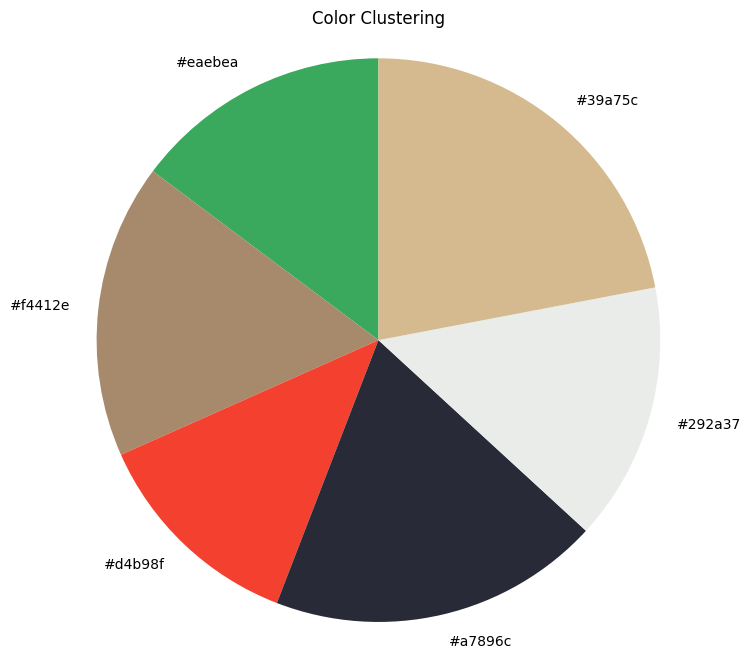

In [ ]:
def rgb2hex(rgb):
    return "#{:02x}{:02x}{:02x}".format(int(rgb[0]), int(rgb[1]), int(rgb[2]))

def overall_color_cluster(directory_path, k=6):
    # Initialize counters for overall color clustering
    overall_label_counts = Counter()
    overall_img_count = 0

    # Iterate through all files in the directory
    for filename in os.listdir(directory_path):
        if filename.endswith(".jpg") or filename.endswith(".png"):
            # Load image
            img_path = os.path.join(directory_path, filename)
            img_bgr = cv2.imread(img_path)
            img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

            # Resize image to speed up processing time
            resized_img_rgb = cv2.resize(img_rgb, (64, 64), interpolation=cv2.INTER_AREA)

            # Reshape the image to be a list of pixels
            img_list = resized_img_rgb.reshape((resized_img_rgb.shape[0] * resized_img_rgb.shape[1], 3))

            # Cluster the pixels and assign labels
            clt = KMeans(n_clusters=k)
            labels = clt.fit_predict(img_list)

            # Count labels to find the most popular
            label_counts = Counter(labels)
            overall_label_counts += label_counts
            overall_img_count += 1

    # Calculate overall percentages
    overall_label_percentages = {label: count / overall_img_count for label, count in overall_label_counts.items()}
    overall_center_colors = [clt.cluster_centers_[i] / 255 for i in overall_label_counts.keys()]
    overall_color_labels = [rgb2hex(overall_center_colors[i] * 255) for i in overall_label_counts.keys()]

    # Print overall color clustering information
    print(f"Overall color clustering across {overall_img_count} images")

    # Plot pie chart
    plt.figure(figsize=(8, 8))
    plt.pie(overall_label_percentages.values(), labels=overall_color_labels, colors=overall_center_colors, startangle=90)
    plt.axis('equal')
    plt.title("Color Clustering")
    plt.show()

directory_path = "/content/images"
overall_color_cluster(directory_path)

SIMILARITY MATRIX

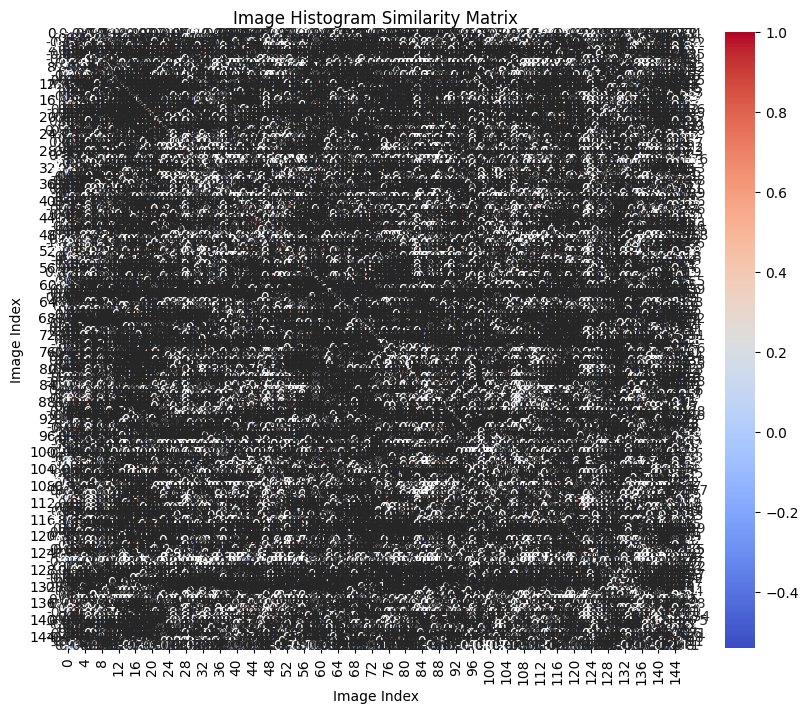

In [ ]:
import os
import cv2
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

def compute_histogram(image, bins=256):
    """Compute the color histogram for an image."""
    histogram = [cv2.calcHist([image], [i], None, [bins], [0, 256]) for i in range(3)]
    return np.concatenate(histogram).flatten()

def calculate_similarity(hist_list):
    """Calculate histogram similarity matrix."""
    num_images = len(hist_list)
    similarity_matrix = np.zeros((num_images, num_images))

    for i in range(num_images):
        for j in range(num_images):
            similarity = cv2.compareHist(hist_list[i], hist_list[j], cv2.HISTCMP_CORREL)
            similarity_matrix[i, j] = similarity

    return similarity_matrix

# Directory containing images
image_directory = 'images'

# Load and process images
image_files = [f for f in os.listdir(image_directory) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
histograms = []

for file in image_files:
    image_path = os.path.join(image_directory, file)
    image = cv2.imread(image_path)
    if image is not None:
        hist = compute_histogram(image)
        histograms.append(hist)

# Calculate the similarity matrix
similarity_matrix = calculate_similarity(histograms)

# Plotting the similarity matrix
plt.figure(figsize=(10, 8))
sns.heatmap(similarity_matrix, annot=True, cmap='coolwarm')
plt.title('Image Histogram Similarity Matrix')
plt.xlabel('Image Index')
plt.ylabel('Image Index')
plt.show()

DENDOGRAM

<ipython-input-10-945b8d2ea06e>:26: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  Z = linkage(1 - similarity_matrix, method='average')


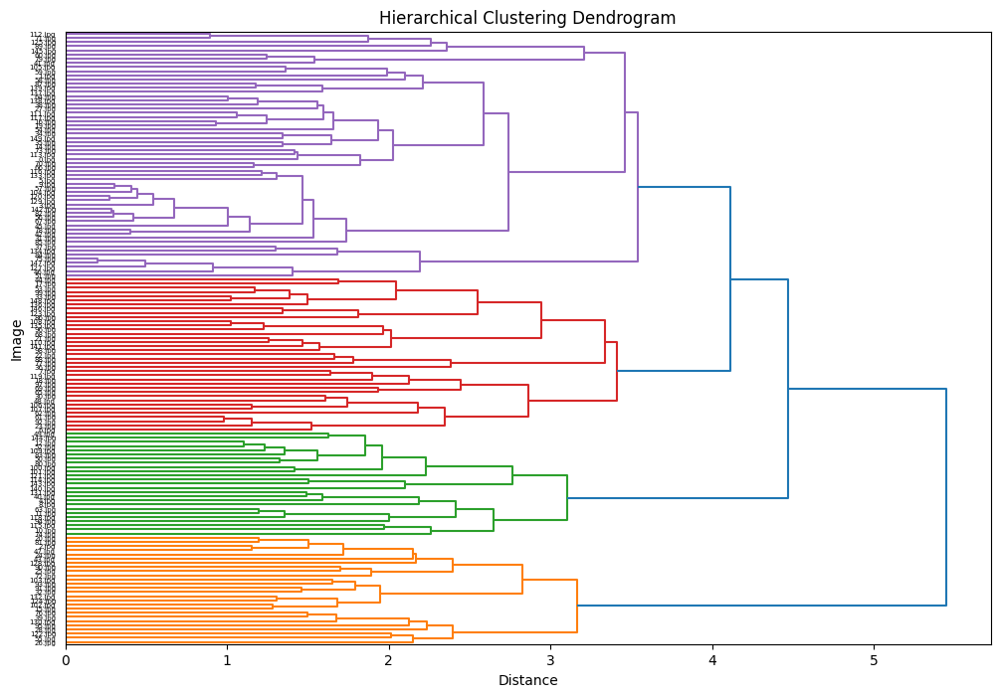

In [ ]:
import os
import cv2
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage

# Directory containing images
image_directory = 'images'

# Load and process images
image_files = [f for f in os.listdir(image_directory) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
histograms = []

for file in image_files:
    image_path = os.path.join(image_directory, file)
    image = cv2.imread(image_path)
    if image is not None:
        hist = compute_histogram(image)
        histograms.append(hist)

# Calculate the similarity matrix
similarity_matrix = calculate_similarity(histograms)

# Perform hierarchical clustering
Z = linkage(1 - similarity_matrix, method='average')

# Plot dendrogram
plt.figure(figsize=(12, 8))
dendrogram(Z, labels=image_files, orientation='right')
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Distance')
plt.ylabel('Image')
plt.show()

<ipython-input-19-579c4520ddf0>:26: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  Z = linkage(1 - similarity_matrix, method='average')


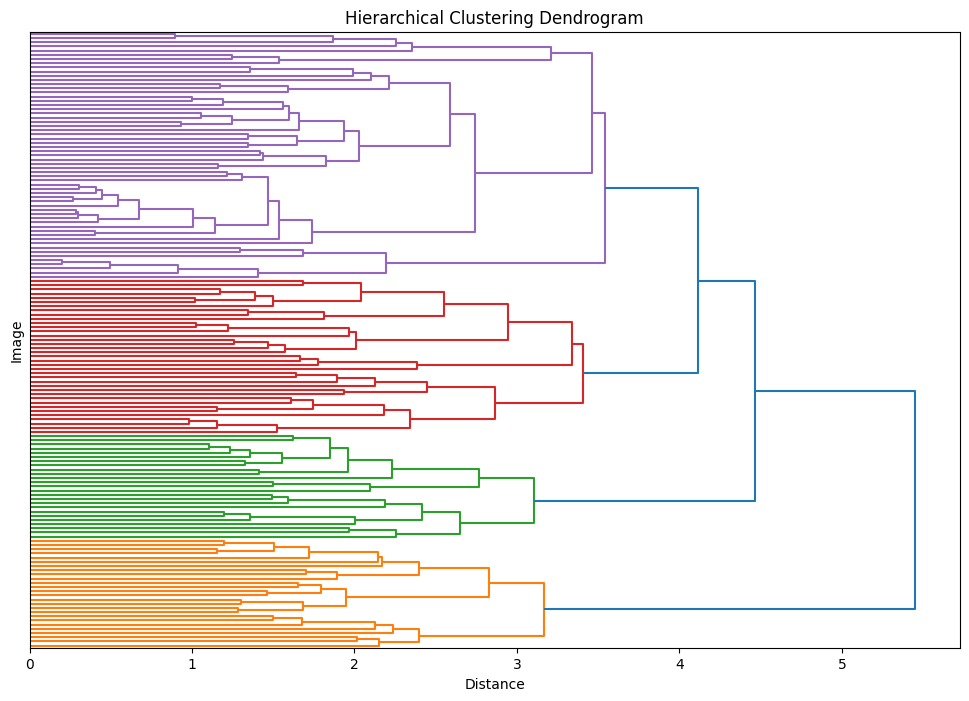

In [ ]:
import os
import cv2
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage

# Directory containing images
image_directory = 'images'

# Load and process images
image_files = [f for f in os.listdir(image_directory) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
histograms = []

for file in image_files:
    image_path = os.path.join(image_directory, file)
    image = cv2.imread(image_path)
    if image is not None:
        hist = compute_histogram(image)
        histograms.append(hist)

# Calculate the similarity matrix
similarity_matrix = calculate_similarity(histograms)

# Perform hierarchical clustering
Z = linkage(1 - similarity_matrix, method='average')

# Plot dendrogram
plt.figure(figsize=(12, 8))
dendrogram(Z, labels=image_files, orientation='right')
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Distance')
plt.ylabel('Image')
plt.tick_params(axis='y', which='both', left=False, labelleft=False)  # Suppress tick labels on y-axis
plt.show()


<ipython-input-11-d7d4cb3d48d9>:41: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  Z = linkage(1 - similarity_matrix, method='average')


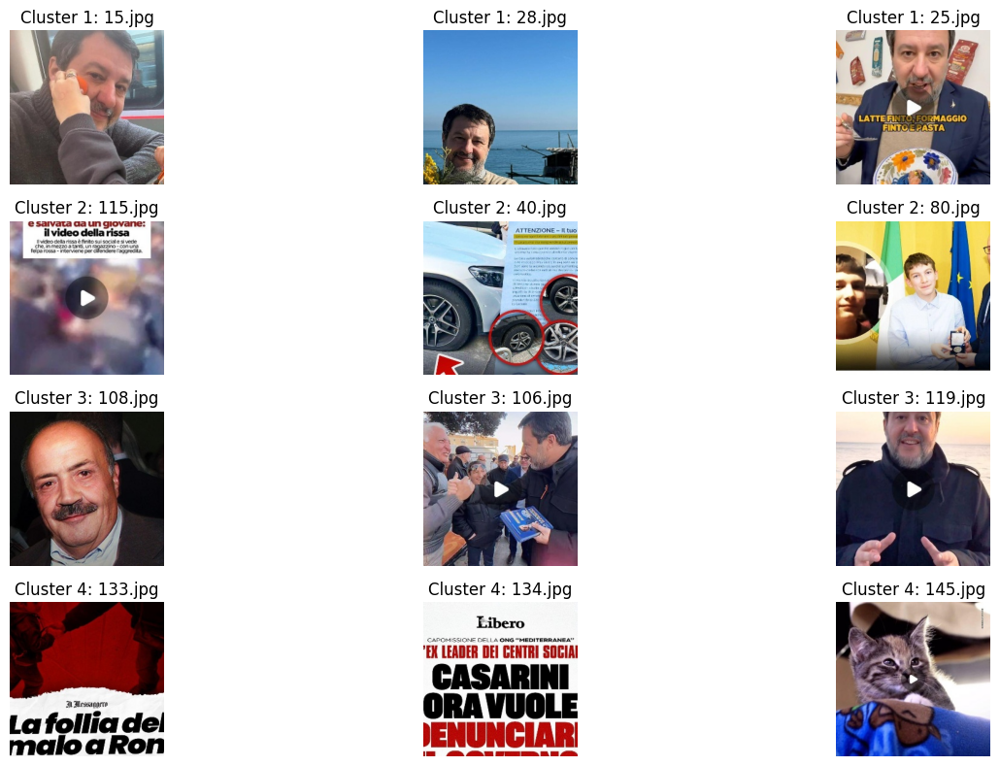

In [ ]:
import os
import cv2
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster

# Define function to pick random images from clusters
def pick_random_images(image_files, clusters, num_images_per_cluster=3):
    random_images = []
    unique_clusters = np.unique(clusters)

    for cluster_id in unique_clusters:
        cluster_indices = np.where(clusters == cluster_id)[0]
        if len(cluster_indices) >= num_images_per_cluster:
            random_indices = np.random.choice(cluster_indices, num_images_per_cluster, replace=False)
            random_images.extend([(image_files[i], cluster_id) for i in random_indices])
        else:
            random_images.extend([(image_files[i], cluster_id) for i in cluster_indices])

    return random_images

# Directory containing images
image_directory = 'images'

# Load and process images
image_files = [f for f in os.listdir(image_directory) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
histograms = []

for file in image_files:
    image_path = os.path.join(image_directory, file)
    image = cv2.imread(image_path)
    if image is not None:
        hist = compute_histogram(image)
        histograms.append(hist)

# Calculate the similarity matrix
similarity_matrix = calculate_similarity(histograms)

# Perform hierarchical clustering
Z = linkage(1 - similarity_matrix, method='average')

# Determine clusters
num_clusters = 4
clusters = fcluster(Z, num_clusters, criterion='maxclust')

# Pick random images from clusters
random_images = pick_random_images(image_files, clusters)

# Display random images grouped by cluster
plt.figure(figsize=(15, 8))
for i, (image_name, cluster_id) in enumerate(random_images, start=1):
    image_path = os.path.join(image_directory, image_name)
    image = cv2.imread(image_path)
    plt.subplot(4, 3, i)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(f'Cluster {cluster_id}: {image_name}')
    plt.axis('off')
plt.tight_layout()
plt.show()


OBJECT DETECTION
At the core functionality of computer vision methods there is object detection. Using an object detection computer vision model will recognise and locate objects in a given image (Szeliski, 2014, p. 295).
To carry out the object detection in Salvini's Instagram posts I used Detectron2. Detectron2 is Facebook AI Research's next generation library that provides state-of-the-art detection and segmentation algorithms. It supports a number of computer vision research projects and production applications in Facebook. (GitHub, https://github.com/facebookresearch/detectron2).
I will use the COCO Panoptic Segmentation task inclede in Detectron2 to individuate the objects present in Salvini's posts. Detectron2 is a popular open-source deep learning library developed by Facebook AI Research (FAIR) for computer vision tasks.

OBJECT DETECTION WITH COCO

In [ ]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core

!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 4.0 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Cloning into 'detectron2'...
remote: Enumerating objects: 15536, done.
remote: Counting objects: 100% (261/261), done.
remote: Compressing objects: 100% (217/217), done.
remote: Total 15536 (delta 85), reused 188 (delta 44), pack-reused 15275
Receiving objects: 100% (15536/15536), 6.41 MiB | 18.90 MiB/s, done.
Resolving deltas: 100% (11200/11200), done.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 3.0 MB/s eta 0:00:

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
torch:  2.2 ; cuda:  cu121
detectron2: 0.6


In [ ]:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
!pip install torch torchvision torchaudio

  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (99 kB)
  Using cached nvidia_nvjitlink_cu12-12.4.127-py3-none-m

In [ ]:
cfg.MODEL.DEVICE = "cpu"

NameError: name 'cfg' is not defined

In [ ]:
import os
import cv2
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from collections import Counter

# Image directory
image_directory = "images"

# Inference with COCO panoptic segmentation model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml"))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml")

# Set to run on CPU
cfg.MODEL.DEVICE = "cpu"
# Initialize the predictor
predictor = DefaultPredictor(cfg)

# Get COCO metadata to map category IDs to category names
coco_metadata = MetadataCatalog.get(cfg.DATASETS.TRAIN[0])

# List to store information for plotting
all_object_counts = Counter()

# Iterate over image files in the directory
for image_file in os.listdir(image_directory):
    if image_file.endswith(('.jpg', '.jpeg', '.png')):
        # Read the image
        img_path = os.path.join(image_directory, image_file)
        img = cv2.imread(img_path)

        # Make predictions
        panoptic_seg, segments_info = predictor(img)["panoptic_seg"]

        # Count occurrences of all object categories
        category_ids = [segment_info['category_id'] for segment_info in segments_info]
        all_object_counts.update(category_ids)


In [ ]:
import matplotlib.pyplot as plt

# Plotting
plt.figure(figsize=(15, 6))

# Bar plot for all object counts
objects_names = [coco_metadata.thing_classes[category_id] for category_id in all_object_counts.keys()]
plt.bar(objects_names, all_object_counts.values())
plt.xlabel('COCO Object Name')
plt.ylabel('Frequency')
plt.title('Object frequency')
plt.xticks(rotation=90, ha='right')

plt.tight_layout()
plt.show()


I was surprised by the high percentage of the category "hot dog", however such thing is understable if you consider that models trained exclusively on panoptic segmentation datasets like COCO may not generalize well to real-world scenarios, which could include different lighting conditions, object orientations, or occlusions. Moreover, one limitation is the inherent bias in the dataset due to class imbalance, which can affect the performance of the models. COCO's design inevitably encompassed certain annotation biases, including issues like imprecise object boundaries and incorrect class labels.
Given these considerations, I manually inspected the pictures and found that none of them contained hot dogs, so I decided to exclude this category from the frequency graph.

In [ ]:
import matplotlib.pyplot as plt

# Filter out "hot dog" category
filtered_object_counts = {category_id: count for category_id, count in all_object_counts.items() if coco_metadata.thing_classes[category_id] != "hot dog"}

# Plotting
plt.figure(figsize=(15, 6))

# Bar plot for filtered object counts
objects_names = [coco_metadata.thing_classes[category_id] for category_id in filtered_object_counts.keys()]
plt.bar(objects_names, filtered_object_counts.values())
plt.xlabel('COCO Object Name')
plt.ylabel('Frequency')
plt.title('Object frequency')
plt.xticks(rotation=90, ha='right')

plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Plotting
plt.figure(figsize=(15, 6))

# Bar plot for all object counts
objects_names = [coco_metadata.thing_classes[category_id] for category_id in all_object_counts.keys()]
object_frequencies = list(all_object_counts.values())
total_objects = sum(object_frequencies)

# Calculate percentages
percentages = [(freq / total_objects) * 100 for freq in object_frequencies]

plt.bar(objects_names, percentages)
plt.xlabel('COCO Object Name')
plt.ylabel('Frequency (%)')
plt.title('Object frequency (%)')
plt.xticks(rotation=90, ha='right')

# Add percentages on top of bars
for i, percentage in enumerate(percentages):
    plt.text(i, percentage + 0.5, f"{percentage:.2f}%", ha='center')

plt.tight_layout()
plt.show()
